In [1]:
%load_ext autoreload
%autoreload 2

import os
import time
import datetime
from tqdm import tqdm
import wandb

import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader, Dataset
import torchvision

import sys
sys.path.append('../../src/')
from build_model import fpn_resnet50_classification

from dataset_functions import list_to_dict, hdf5_dataset, viz_dataloader
from analysis_functions import confusion_matrix, plot_cm

symmetry_classes = ['p1', 'p2', 'pm', 'pg', 'cm', 'pmm', 'pmg', 'pgg', 'cmm', 
                 'p4', 'p4m', 'p4g', 'p3', 'p3m1', 'p31m', 'p6', 'p6m']
label_converter = list_to_dict(symmetry_classes)

In [2]:
model = fpn_resnet50_classification(n_classes=17)
print(model(torch.randn(2, 3, 256, 256)).shape)

torch.Size([2, 17])


/Users/yg446/anaconda3/envs/gyc/lib/python3.10/site-packages/torch/nn/functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


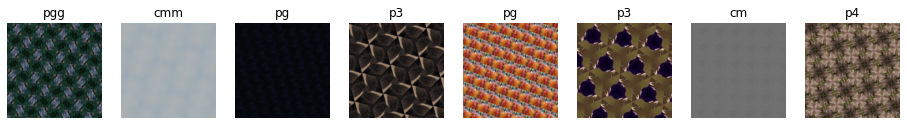

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


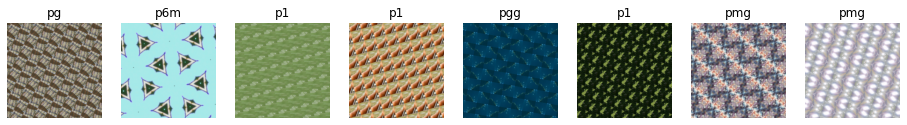

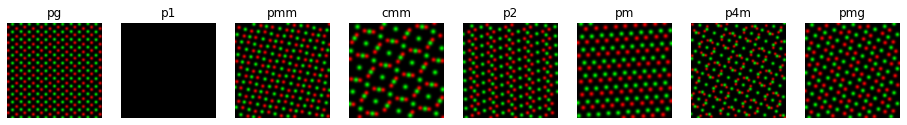

CPU times: user 13.7 s, sys: 2.31 s, total: 16 s
Wall time: 24.3 s


In [3]:
%%time
# imagenet
torch_transform = transforms.Compose([transforms.ToTensor(), transforms.Resize((224, 224), antialias=True)])

train_ds = hdf5_dataset('/scratch/yichen/imagenet_v4_rot_10m_train_unchunked.h5', folder='train', transform=torch_transform)
train_dl = DataLoader(train_ds, batch_size=700, shuffle=True, num_workers=4)

valid_ds = hdf5_dataset('/scratch/yichen/imagenet_v4_rot_2m_valid_unchunked.h5', folder='valid', transform=torch_transform)
valid_dl = DataLoader(valid_ds, batch_size=700, shuffle=True, num_workers=4)


test_ds = hdf5_dataset('/scratch/yichen/atom_v4_rot_2m_unchunked_fixed.h5', folder='test', transform=torch_transform)
test_dl = DataLoader(test_ds, batch_size=1000, shuffle=True, num_workers=4)

viz_dataloader(train_dl, label_converter=label_converter)
viz_dataloader(valid_dl, label_converter=label_converter)
viz_dataloader(test_dl, label_converter=label_converter)

# visualize layer outputs in fpn

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import torch
import torchvision
from torchvision import transforms

sys.path.append('../../../from_others/PytorchRevelio/')
from PytorchRevelio import PytorchRevelio
from utilities_PytorchRevelio import imagenet_labels

sys.path.append('../../../helper_functions/')
from visualization_functions import show_images

def show_layer_outputs(input_image):
    outputs = []
    labels = []
    # network transformer for input image
    img_transformer = transforms.ToTensor()

    # for different convolutional filter and neuron in fully connected layer
    first_layer_name = 'conv1'
    last_layer_name = 'layer4.2.conv3'
    for layer_name in model.named_modules():

        layer_name = layer_name[0]

        # if layer_name != '' and layer_name[-1] == '1':
        # select convolutional and fully connected layers for visualization
        layer = PytorchRevelio.return_module_by_name(network=model, module_name=layer_name)

        if isinstance(layer, nn.Conv2d) and layer_name[-5:] in ['conv1', 'conv2', 'conv3']:
            filter_neuron_num = layer.out_channels
            layer_type = 'Conv2d'
            num_iter = 150
            lr = 1
        # else:
        #     continue

            # from each layer select 8 filter our neurons
            # filters_neuron_indexs = np.random.choice([i for i in range(filter_neuron_num)], size=8)
            # filters_neuron_indexs = [0]
            filters_neuron_indexs = range(filter_neuron_num)[:3]

            for i, filter_neuron_index in enumerate(filters_neuron_indexs):

                img = PytorchRevelio.activation_maximization(network=model, img_transformer=img_transformer,
                                                            in_img_size=(224, 224, 3), input_image=input_image,
                                                            first_layer_name=first_layer_name, layer_name=layer_name,
                                                            filter_or_neuron_index=filter_neuron_index, num_iter=num_iter,
                                                            lr=lr, device=device)

                # to cpu and normalize for illustration purpose
                # img = PytorchRevelio.tensor_outputs_to_image(img)
                img = img.detach().cpu().squeeze()
                img = torch.permute(img, (1, 2, 0)).numpy()
                outputs.append(img)
                labels.append(layer_name)

                print('Processing of layer {}, filter/neuron {} is done.'.format(layer_name, filter_neuron_index))


    outputs_np = np.array(outputs)
    show_images(outputs_np, labels=labels)

In [15]:
device = torch.device('cuda:3')
model = torch.load('/scratch/yichen/models_new/07242023-fpn_resnet50-epoch-19.pt', map_location=device)
model = model.backbone.body
print(model)

train_ds = hdf5_dataset('/scratch/yichen/imagenet_v4_rot_10m_train_unchunked.h5', folder='train')

IntermediateLayerGetter(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): FrozenBatchNorm2d(64, eps=1e-05)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=1e-05)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): FrozenBatchNorm2d(64, eps=1e-05)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): FrozenBatchNorm2d(256, eps=1e-05)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(256, eps=1e-05)
      )
    )
    (1): Bottleneck(
      (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=Fa

In [23]:
    for layer_name in model.named_modules():

        layer_name = layer_name[0]
        print(layer_name)


conv1
bn1
relu
maxpool
layer1
layer1.0
layer1.0.conv1
layer1.0.bn1
layer1.0.conv2
layer1.0.bn2
layer1.0.conv3
layer1.0.bn3
layer1.0.relu
layer1.0.downsample
layer1.0.downsample.0
layer1.0.downsample.1
layer1.1
layer1.1.conv1
layer1.1.bn1
layer1.1.conv2
layer1.1.bn2
layer1.1.conv3
layer1.1.bn3
layer1.1.relu
layer1.2
layer1.2.conv1
layer1.2.bn1
layer1.2.conv2
layer1.2.bn2
layer1.2.conv3
layer1.2.bn3
layer1.2.relu
layer2
layer2.0
layer2.0.conv1
layer2.0.bn1
layer2.0.conv2
layer2.0.bn2
layer2.0.conv3
layer2.0.bn3
layer2.0.relu
layer2.0.downsample
layer2.0.downsample.0
layer2.0.downsample.1
layer2.1
layer2.1.conv1
layer2.1.bn1
layer2.1.conv2
layer2.1.bn2
layer2.1.conv3
layer2.1.bn3
layer2.1.relu
layer2.2
layer2.2.conv1
layer2.2.bn1
layer2.2.conv2
layer2.2.bn2
layer2.2.conv3
layer2.2.bn3
layer2.2.relu
layer2.3
layer2.3.conv1
layer2.3.bn1
layer2.3.conv2
layer2.3.bn2
layer2.3.conv3
layer2.3.bn3
layer2.3.relu
layer3
layer3.0
layer3.0.conv1
layer3.0.bn1
layer3.0.conv2
layer3.0.bn2
layer3.0.conv

In [ ]:
def show_layer_outputs(input_image):
    outputs = []
    labels = []
    # network transformer for input image
    img_transformer = transforms.ToTensor()

    # for different convolutional filter and neuron in fully connected layer
    first_layer_name = 'conv1'
    last_layer_name = 'layer4.2.conv3'
    for layer_name in model.named_modules():

        layer_name = layer_name[0]

        layer = PytorchRevelio.return_module_by_name(network=model, module_name=layer_name)

        # if isinstance(layer, nn.Conv2d) and layer_name[-5:] in ['conv1', 'conv2', 'conv3']:
        if isinstance(layer, nn.Conv2d):
            filter_neuron_num = layer.out_channels
            layer_type = 'Conv2d'
            num_iter = 10
            lr = 1
            
            filter_neuron_index = 0
            img = PytorchRevelio.activation_maximization(network=model, img_transformer=img_transformer,
                                                        in_img_size=(224, 224, 3), input_img=input_image,
                                                        first_layer_name=first_layer_name, layer_name=layer_name,
                                                        filter_or_neuron_index=filter_neuron_index, num_iter=num_iter,
                                                        lr=lr, device=device)

            # to cpu and normalize for illustration purpose
            # img = PytorchRevelio.tensor_outputs_to_image(img)
            img = img.detach().cpu().squeeze()
            img = torch.permute(img, (1, 2, 0)).numpy()
            outputs.append(img)
            labels.append(layer_name)

            print('Processing of layer {}, filter/neuron {} is done.'.format(layer_name, filter_neuron_index))

    outputs_np = np.array(outputs)
    show_images(outputs_np[:,:,:,0], labels=labels, img_per_row=4, img_height=3, show_colorbar=True, clim=3)
    show_images(outputs_np[:,:,:,1], labels=labels, img_per_row=4, img_height=3, show_colorbar=True, clim=3)
    show_images(outputs_np[:,:,:,2], labels=labels, img_per_row=4, img_height=3, show_colorbar=True, clim=3)
    return outputs_np, labels


# for i in range(len(train_ds))[:1]:
#     print('image index:', i)
#     input_image = train_ds[i][0]
#     plt.imshow(input_image)
#     plt.show()

#     outputs, labels = show_layer_outputs(input_image)
i = 0
print('image index:', i)
input_image = train_ds[i][0]
plt.imshow(input_image)
plt.show()

outputs, labels = show_layer_outputs(input_image)

In [21]:
labels[1]

'layer1.0.conv1'

In [61]:
outputs_reorg = []
labels_reorg = []
for n_b in range(3):
    for conv_name in ['conv1', 'conv2', 'conv3']:
        for c in range(3):
            for i in range(len(outputs)):
                if '.'+str(n_b)+'.' in labels[i] and  conv_name in labels[i]:
                    # print(labels[i], n_b, conv_name, c)
                    outputs_reorg.append(outputs[i][:,:,c])
                    labels_reorg.append(labels[i]+'-c'+str(c))

show_images(np.array(outputs_reorg), labels=labels_reorg, img_per_row=4, img_height=1.5, show_colorbar=True, clim=3)

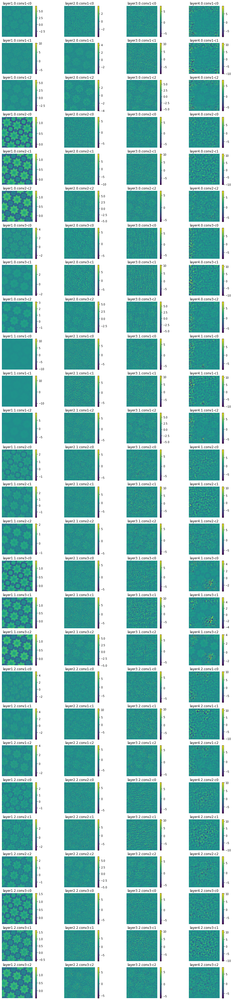

In [62]:
show_images(np.array(outputs_reorg), labels=labels_reorg, img_per_row=4, img_height=1.5, show_colorbar=True, clim=3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

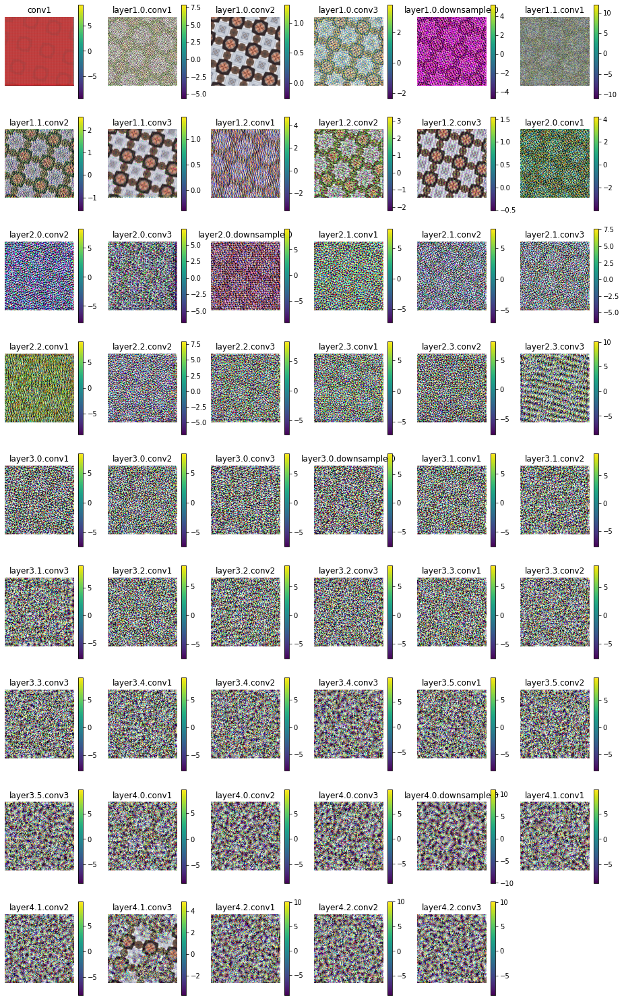

In [19]:
show_images(outputs, labels=labels, img_per_row=6, img_height=2, show_colorbar=True, clim=3)

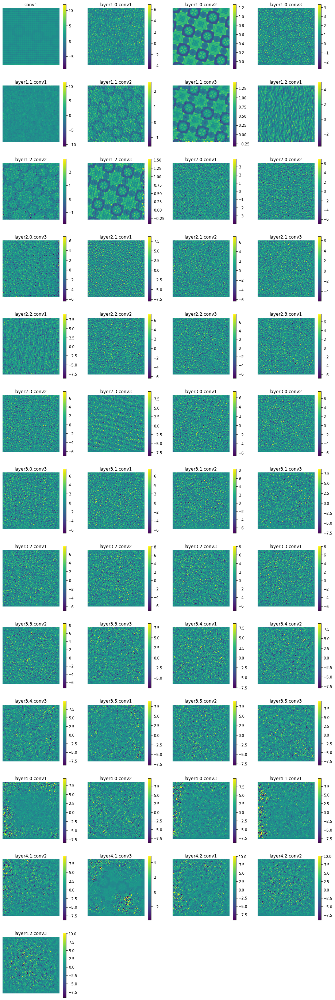

In [83]:
show_images(outputs[:,:,:,0], labels=labels, img_per_row=4, img_height=3, show_colorbar=True, clim=3)

In [76]:
# select from list
labels_selected = [labels[i] for i in indexes]
outputs_selected = outputs[indexes]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


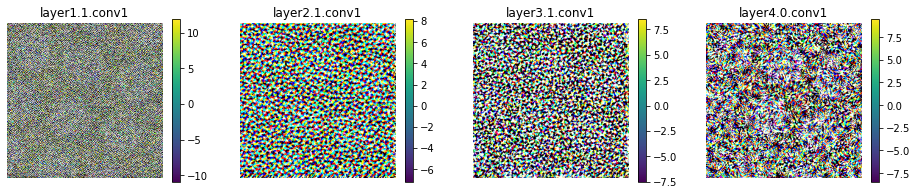

In [77]:
indexes = [2,5,9,14]
show_images(outputs_selected, labels=labels_selected, img_per_row=4, show_colorbar=True, clim=3)

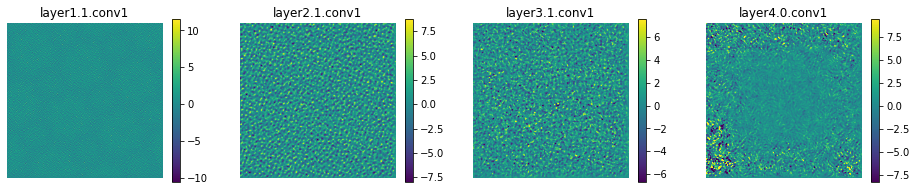

In [78]:
show_images(outputs_selected[:,:,:,0], labels=labels_selected, img_per_row=4, show_colorbar=True, clim=3)


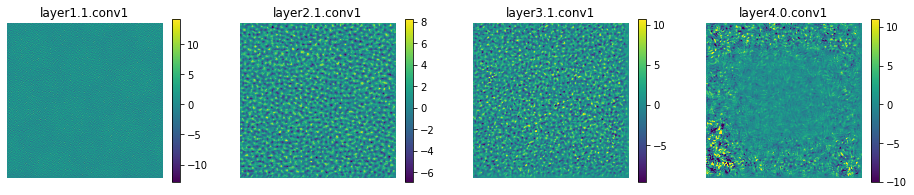

In [79]:
show_images(outputs_selected[:,:,:,1], labels=labels_selected, img_per_row=4, show_colorbar=True, clim=3)


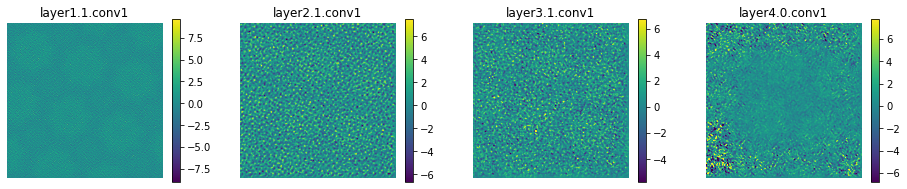

In [80]:
show_images(outputs_selected[:,:,:,2], labels=labels_selected, img_per_row=4, show_colorbar=True, clim=3)


In [73]:
for i, img in enumerate(outputs_selected):
    outputs_selected[i] += np.abs(np.min(outputs_selected[i]))
    outputs_selected[i] /= np.max(outputs_selected[i])

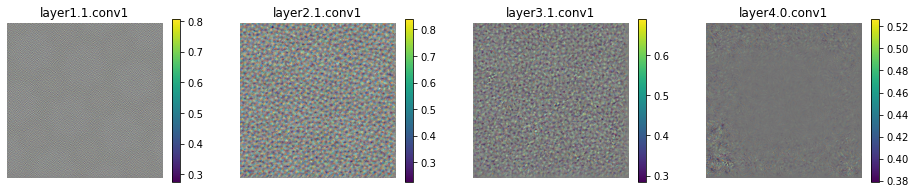

In [74]:
indexes = [2,5,9,14]
show_images(outputs_selected, labels=labels_selected, img_per_row=4, show_colorbar=True, clim=3)

In [ ]:
plt.imshow(outputs[2])

image index: 0


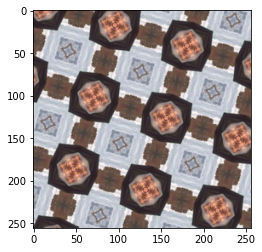

/scratch/yichen/anaconda3/envs/gyc/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


Processing of layer conv1, filter/neuron 0 is done.
Processing of layer conv1, filter/neuron 1 is done.
Processing of layer conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv1, filter/neuron 0 is done.
Processing of layer layer1.0.conv1, filter/neuron 1 is done.
Processing of layer layer1.0.conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv2, filter/neuron 0 is done.
Processing of layer layer1.0.conv2, filter/neuron 1 is done.
Processing of layer layer1.0.conv2, filter/neuron 2 is done.
Processing of layer layer1.0.conv3, filter/neuron 0 is done.
Processing of layer layer1.0.conv3, filter/neuron 1 is done.
Processing of layer layer1.0.conv3, filter/neuron 2 is done.
Processing of layer layer1.1.conv1, filter/neuron 0 is done.
Processing of layer layer1.1.conv1, filter/neuron 1 is done.
Processing of layer layer1.1.conv1, filter/neuron 2 is done.
Processing of layer layer1.1.conv2, filter/neuron 0 is done.
Processing of layer layer1.1.conv2, filter/neuron 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

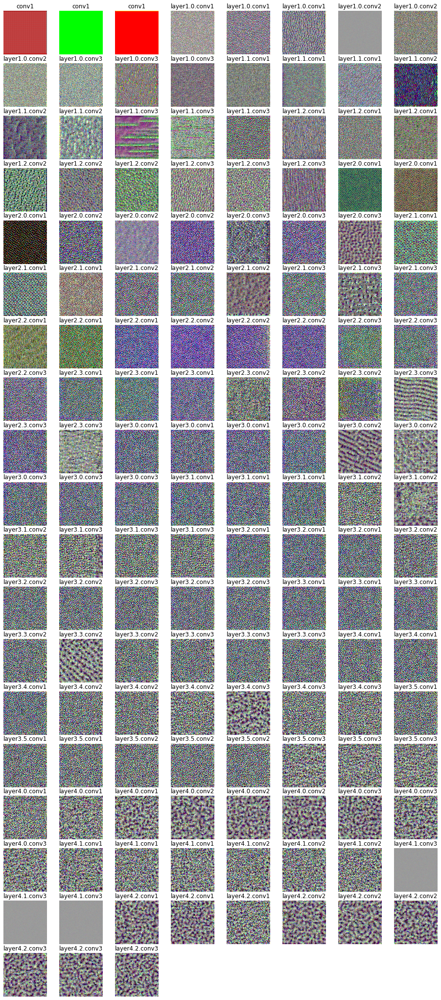

image index: 1


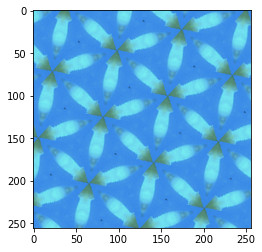

Processing of layer conv1, filter/neuron 0 is done.
Processing of layer conv1, filter/neuron 1 is done.
Processing of layer conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv1, filter/neuron 0 is done.
Processing of layer layer1.0.conv1, filter/neuron 1 is done.
Processing of layer layer1.0.conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv2, filter/neuron 0 is done.
Processing of layer layer1.0.conv2, filter/neuron 1 is done.
Processing of layer layer1.0.conv2, filter/neuron 2 is done.
Processing of layer layer1.0.conv3, filter/neuron 0 is done.
Processing of layer layer1.0.conv3, filter/neuron 1 is done.
Processing of layer layer1.0.conv3, filter/neuron 2 is done.
Processing of layer layer1.1.conv1, filter/neuron 0 is done.
Processing of layer layer1.1.conv1, filter/neuron 1 is done.
Processing of layer layer1.1.conv1, filter/neuron 2 is done.
Processing of layer layer1.1.conv2, filter/neuron 0 is done.
Processing of layer layer1.1.conv2, filter/neuron 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

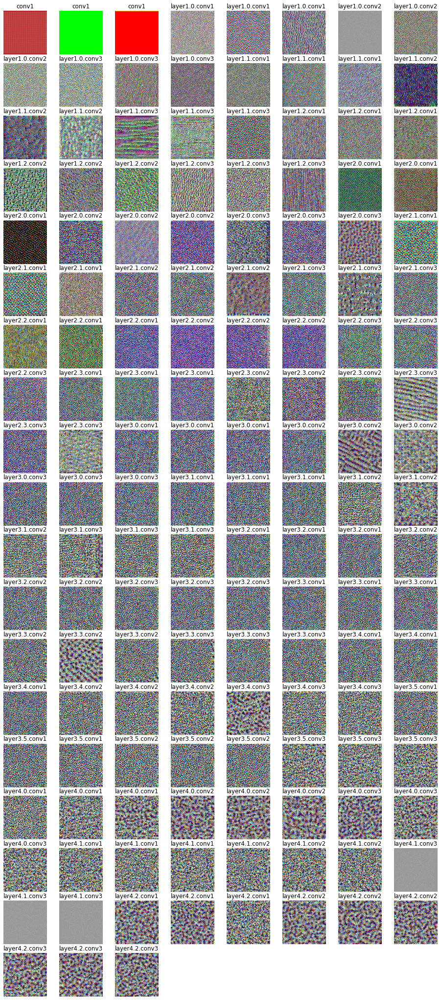

image index: 2


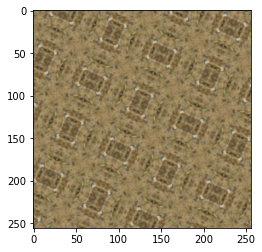

Processing of layer conv1, filter/neuron 0 is done.
Processing of layer conv1, filter/neuron 1 is done.
Processing of layer conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv1, filter/neuron 0 is done.
Processing of layer layer1.0.conv1, filter/neuron 1 is done.
Processing of layer layer1.0.conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv2, filter/neuron 0 is done.
Processing of layer layer1.0.conv2, filter/neuron 1 is done.
Processing of layer layer1.0.conv2, filter/neuron 2 is done.
Processing of layer layer1.0.conv3, filter/neuron 0 is done.
Processing of layer layer1.0.conv3, filter/neuron 1 is done.
Processing of layer layer1.0.conv3, filter/neuron 2 is done.
Processing of layer layer1.1.conv1, filter/neuron 0 is done.
Processing of layer layer1.1.conv1, filter/neuron 1 is done.
Processing of layer layer1.1.conv1, filter/neuron 2 is done.
Processing of layer layer1.1.conv2, filter/neuron 0 is done.
Processing of layer layer1.1.conv2, filter/neuron 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

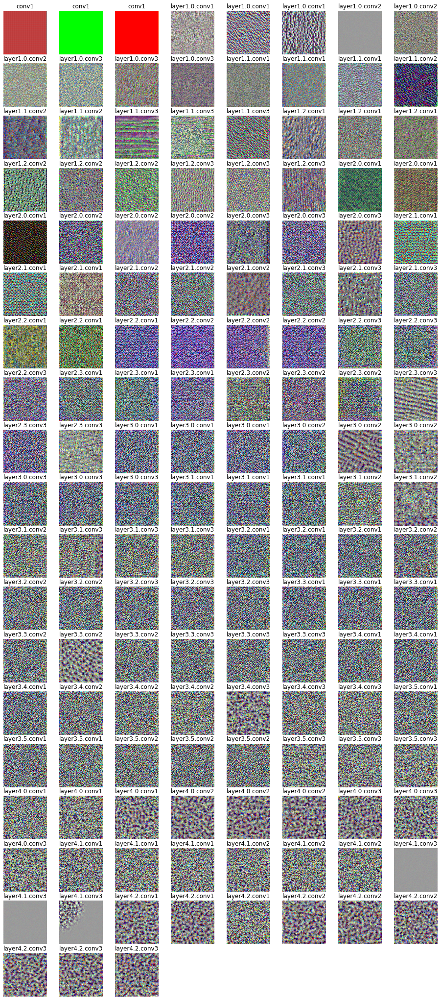

image index: 3


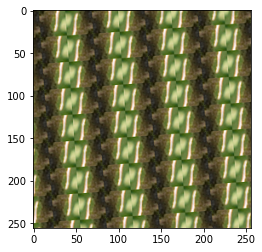

Processing of layer conv1, filter/neuron 0 is done.
Processing of layer conv1, filter/neuron 1 is done.
Processing of layer conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv1, filter/neuron 0 is done.
Processing of layer layer1.0.conv1, filter/neuron 1 is done.
Processing of layer layer1.0.conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv2, filter/neuron 0 is done.
Processing of layer layer1.0.conv2, filter/neuron 1 is done.
Processing of layer layer1.0.conv2, filter/neuron 2 is done.
Processing of layer layer1.0.conv3, filter/neuron 0 is done.
Processing of layer layer1.0.conv3, filter/neuron 1 is done.
Processing of layer layer1.0.conv3, filter/neuron 2 is done.
Processing of layer layer1.1.conv1, filter/neuron 0 is done.
Processing of layer layer1.1.conv1, filter/neuron 1 is done.
Processing of layer layer1.1.conv1, filter/neuron 2 is done.
Processing of layer layer1.1.conv2, filter/neuron 0 is done.
Processing of layer layer1.1.conv2, filter/neuron 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

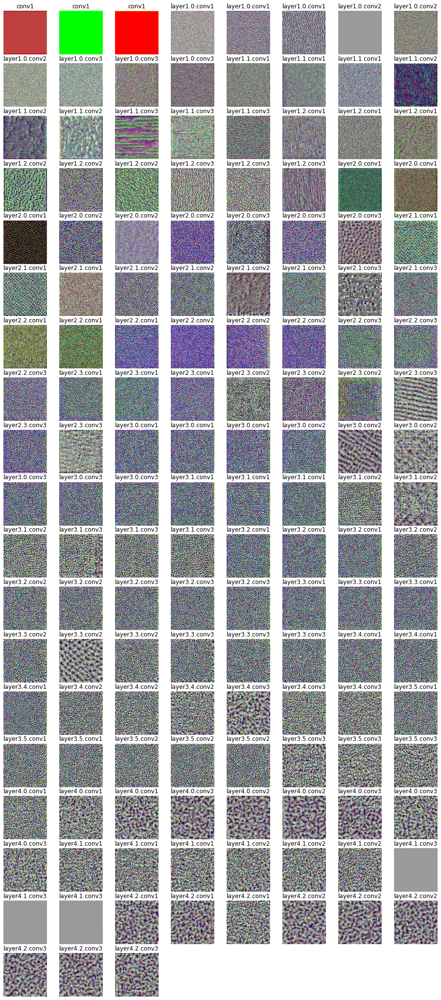

image index: 4


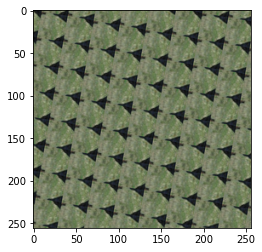

Processing of layer conv1, filter/neuron 0 is done.
Processing of layer conv1, filter/neuron 1 is done.
Processing of layer conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv1, filter/neuron 0 is done.
Processing of layer layer1.0.conv1, filter/neuron 1 is done.
Processing of layer layer1.0.conv1, filter/neuron 2 is done.
Processing of layer layer1.0.conv2, filter/neuron 0 is done.
Processing of layer layer1.0.conv2, filter/neuron 1 is done.
Processing of layer layer1.0.conv2, filter/neuron 2 is done.
Processing of layer layer1.0.conv3, filter/neuron 0 is done.
Processing of layer layer1.0.conv3, filter/neuron 1 is done.
Processing of layer layer1.0.conv3, filter/neuron 2 is done.
Processing of layer layer1.1.conv1, filter/neuron 0 is done.
Processing of layer layer1.1.conv1, filter/neuron 1 is done.
Processing of layer layer1.1.conv1, filter/neuron 2 is done.
Processing of layer layer1.1.conv2, filter/neuron 0 is done.
Processing of layer layer1.1.conv2, filter/neuron 1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

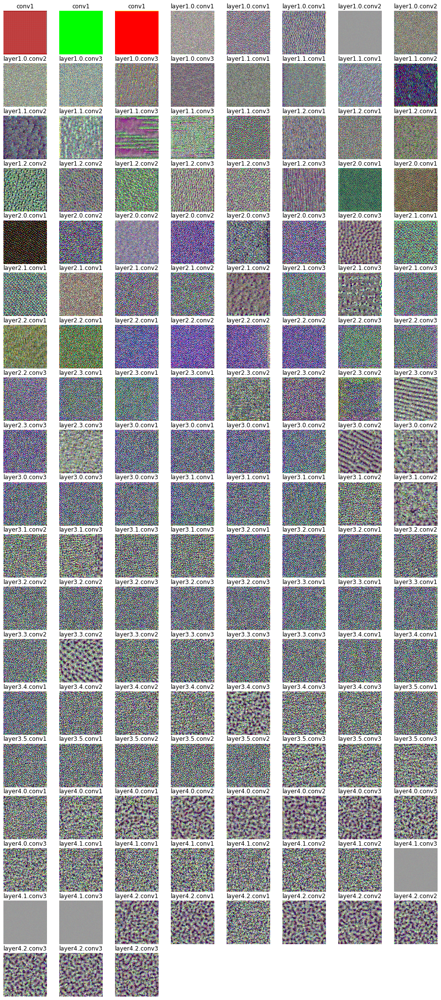

In [21]:
for i in range(len(train_ds))[:5]:
    print('image index:', i)
    input_image = train_ds[i][0]
    plt.imshow(input_image)
    plt.show()

    show_layer_outputs(input_image)

/scratch/yichen/anaconda3/envs/gyc/lib/python3.8/site-packages/torch/nn/modules/module.py:1344: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for int

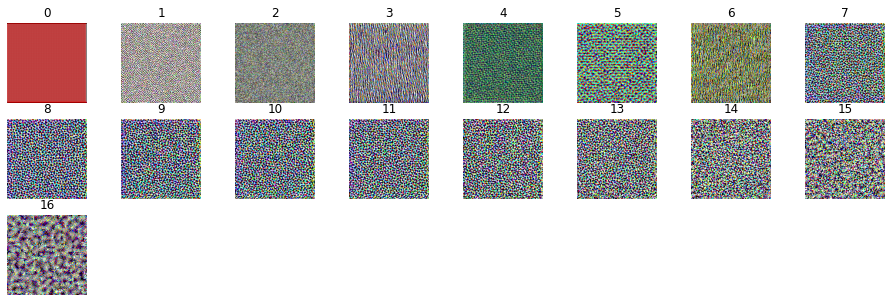

In [68]:
outputs = []

# network transformer for input image
img_transformer = transforms.ToTensor()

# for different convolutional filter and neuron in fully connected layer
first_layer_name = 'conv1'
last_layer_name = 'layer4.2.conv3'
for layer_name in model.named_modules():

    layer_name = layer_name[0]
    if layer_name != '' and layer_name[-1] == '1':
        # select convolutional and fully connected layers for visualization
        layer = PytorchRevelio.return_module_by_name(network=model, module_name=layer_name)

        if isinstance(layer, nn.Conv2d):
            filter_neuron_num = layer.out_channels
            layer_type = 'Conv2d'
            num_iter = 150
            lr = 1
        else:
            continue

        # from each layer select 8 filter our neurons
        # filters_neuron_indexs = np.random.choice([i for i in range(filter_neuron_num)], size=8)
        filters_neuron_indexs = [0]

        filter_neuron_index = 0
        img = PytorchRevelio.activation_maximization(network=model, img_transformer=img_transformer,
                                                    in_img_size=(224, 224, 3), input_image=input_image,
                                                    first_layer_name=first_layer_name, layer_name=layer_name,
                                                    filter_or_neuron_index=filter_neuron_index, num_iter=num_iter,
                                                    lr=lr, device=device)

        # to cpu and normalize for illustration purpose
        # img = PytorchRevelio.tensor_outputs_to_image(img)
        img = img.detach().cpu().squeeze()
        img = torch.permute(img, (1, 2, 0)).numpy()
        outputs.append(img)

outputs_np = np.array(outputs)
show_images(outputs_np)

In [56]:
outputs_np

array([[[[-1.28648930e+01, -2.14588501e+02, -1.89635986e+02],
         [-1.26423569e+01, -2.36516678e+02, -2.08722336e+02],
         [ 1.49357581e+00, -1.62628189e+02, -1.42425323e+02],
         ...,
         [-1.26602497e+01, -8.20146637e+01, -6.70497742e+01],
         [-5.92623806e+00, -8.61687241e+01, -6.49931335e+01],
         [ 1.03550472e+01,  5.15662041e+01,  5.83352242e+01]],

        [[ 3.52881165e+01, -1.79434952e+02, -1.94963806e+02],
         [-2.91503754e+01, -2.91190979e+02, -2.99144104e+02],
         [-7.19276667e+00, -2.48760468e+02, -2.61102234e+02],
         ...,
         [-6.31527863e+01, -2.44347504e+02, -2.40460815e+02],
         [-5.64219589e+01, -2.10704254e+02, -1.89044052e+02],
         [-5.62187119e+01, -1.32817413e+02, -1.18042595e+02]],

        [[ 8.58849640e+01, -1.45070438e+01, -1.82137394e+01],
         [ 5.43044357e+01, -6.49042969e+01, -6.14717407e+01],
         [ 7.51346817e+01, -5.52334023e+01, -6.45288620e+01],
         ...,
         [ 3.99120255e+0

In [51]:
print(outputs_np.shape)

(17, 224, 224, 3)


In [52]:
sys.path.append('../../../helper_functions/')
from visualization_functions import show_images

In [64]:
outputs_np = (outputs_np/255.).astype(np.float32)

In [24]:
outputs = np.array(outputs)

<ipython-input-24-c48386d5b972>:1: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  outputs = np.array(outputs)
<ipython-input-24-c48386d5b972>:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  outputs = np.array(outputs)


In [26]:
outputs.shape

(17,)

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import torch
import torchvision
from torchvision import transforms

sys.path.append('../../../from_others/PytorchRevelio/')
from PytorchRevelio import PytorchRevelio
from utilities_PytorchRevelio import imagenet_labels

In [14]:
if __name__ == '__main__':

    # load pretrained Alexnet
    alexnet_net = torchvision.models.alexnet(pretrained=True)

    # choose GPU if it is available
    device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")
    print('Device: {}'.format(device))

    # put network on device
    alexnet_net.to(device)

    # print name of modules
    for key, value in PytorchRevelio.layers_name_type(alexnet_net):
        print('+' * 10)
        print(key)
        print('-' * 10)
        print(value)

    # network transformer for input image
    img_transformer = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    # for different convolutional filter and neuron in fully connected layer
    # show representation
    first_layer_name = 'features.0'
    last_layer_name = 'classifier.6'
    for layer_name in alexnet_net.named_modules():

        layer_name = layer_name[0]

        # select convolutional and fully connected layers for visualization
        layer = PytorchRevelio.return_module_by_name(network=alexnet_net, module_name=layer_name)

        if isinstance(layer, nn.Conv2d):
            filter_neuron_num = layer.out_channels
            layer_type = 'Conv2d'
            num_iter = 150
            lr = 1
        elif isinstance(layer, nn.Linear):
            filter_neuron_num = layer.out_features
            layer_type = 'Linear'
            num_iter = 500
            lr = 1
        else:
            continue

        # from each layer select 8 filter our neurons
        filters_neuron_indexs = np.random.choice([i for i in range(filter_neuron_num)], size=8)

        # for each selected filter or neuron, calculate representation
        plt.figure()
        for i, filter_neuron_index in enumerate(filters_neuron_indexs):
            img = PytorchRevelio.activation_maximization(network=alexnet_net, img_transformer=img_transformer,
                                                         in_img_size=(224, 224, 3),
                                                         first_layer_name=first_layer_name, layer_name=layer_name,
                                                         filter_or_neuron_index=filter_neuron_index, num_iter=num_iter,
                                                         lr=lr, device=device)

            # to cpu and normalize for illustration purpose
            img = PytorchRevelio.tensor_outputs_to_image(img)

            # Illustrate
            ax = plt.subplot(2, 4, i+1)
            plt.imshow(img)
            if layer_name != last_layer_name:
                ax.set_title("{}".format(filter_neuron_index))
            else:
                ax.set_title("{}, {}".format(filter_neuron_index, imagenet_labels(class_number=filter_neuron_index)))

            plt.suptitle('Layer Name: {}, Type: {}'.format(layer_name, layer_type))
            ax.axis('off')
            print('Processing of layer {}, filter/neuron {} is done.'.format(layer_name, filter_neuron_index))

    plt.show()

/scratch/yichen/anaconda3/envs/gyc/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/scratch/yichen/anaconda3/envs/gyc/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cuda:3
++++++++++

----------
AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features

KeyError: 'backbone'

# analyze

In [ ]:
# model = torch.load('/scratch/yichen/models/05312023-benchmark-resnet50_from_scratch-v4_10m-epoch-19.pt')

In [9]:
device = torch.device('cuda:2')

cm = confusion_matrix(model, train_dl, symmetry_classes, device, n_batches='all')
np.save(NAME+'-train_cm.npy', cm)

100%|██████████| 14286/14286 [2:11:08<00:00,  1.82it/s] 


Sum for true labels:


,p1,p2,pm,pg,cm,pmm,pmg,pgg,cmm,p4,p4m,p4g,p3,p3m1,p31m,p6,p6m
0,588308.0,588239.0,588239.0,588233.0,588232.0,588231.0,588236.0,588232.0,588239.0,588237.0,588238.0,588239.0,588239.0,588224.0,588239.0,588238.0,588237.0


Accuracy for these batches: 0.9994810041519668


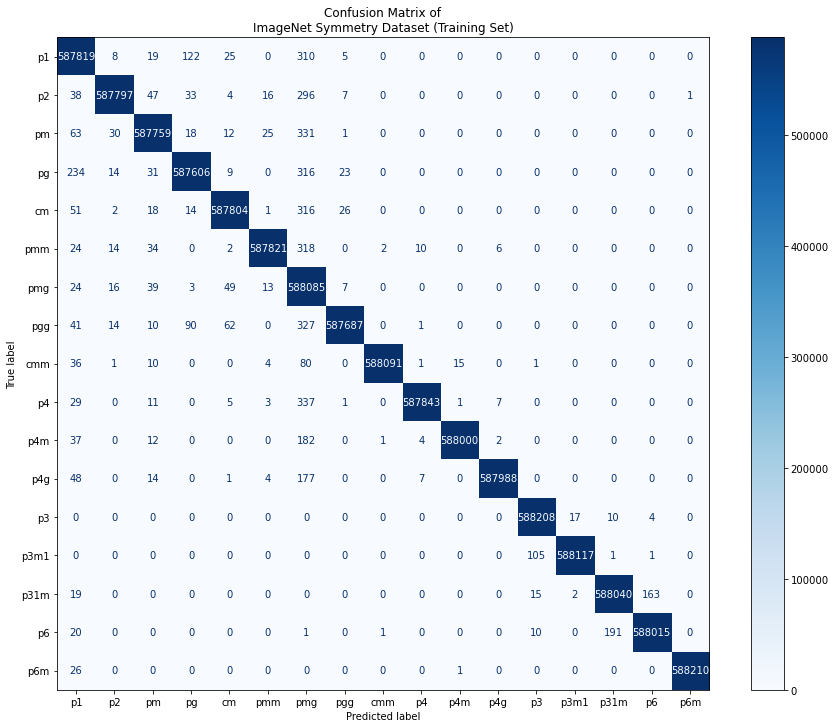

In [12]:
cm = np.load('./07242023-fpn_resnet50-train_cm.npy')

plot_cm(cm, symmetry_classes, save_file=None, title='\nImageNet Symmetry Dataset (Training Set)', style='simple', figsize=(15,12))
# plot_cm(cm, symmetry_classes, save_file=None, style='with_axis')

In [11]:
cm = confusion_matrix(model, valid_dl, symmetry_classes, device, n_batches='all')
np.save(NAME+'-valid_cm.npy', cm)

100%|██████████| 2858/2858 [26:07<00:00,  1.82it/s]

Sum for true labels:


,p1,p2,pm,pg,cm,pmm,pmg,pgg,cmm,p4,p4m,p4g,p3,p3m1,p31m,p6,p6m
0,117670.0,117647.0,117647.0,117647.0,117646.0,117646.0,117648.0,117647.0,117647.0,117646.0,117647.0,117648.0,117647.0,117645.0,117645.0,117646.0,117647.0


Accuracy for these batches: 0.9990545075639395


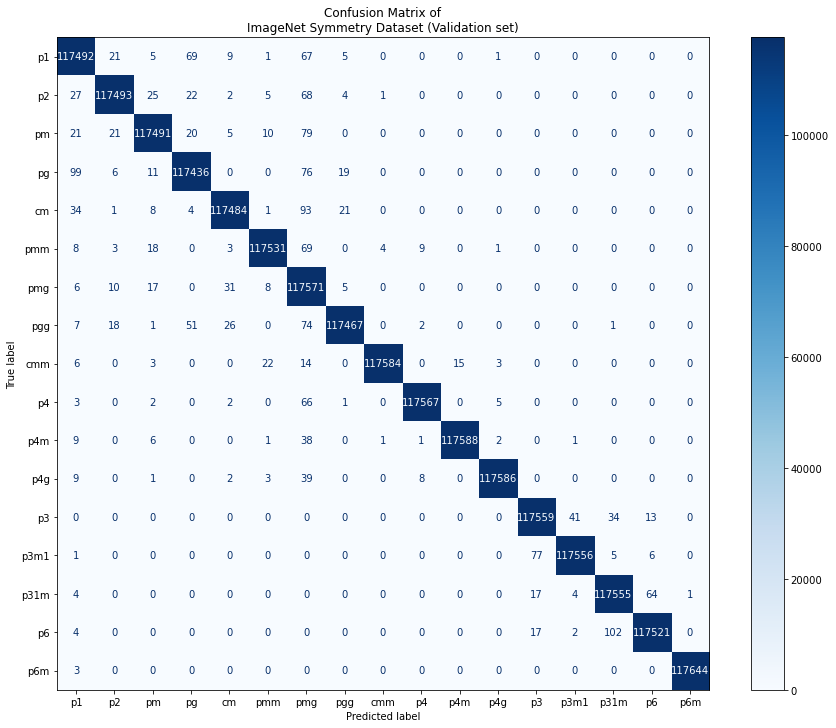

In [13]:
cm = np.load('./07242023-fpn_resnet50-valid_cm.npy')

plot_cm(cm, symmetry_classes, save_file=None, title='\nImageNet Symmetry Dataset (Validation set)', style='simple', figsize=(15,12))
# plot_cm(cm, symmetry_classes, save_file=None, style='with_axis')

In [13]:
cm = confusion_matrix(model, test_dl, symmetry_classes, device, n_batches='all')
np.save(NAME+'-test_cm.npy', cm)

100%|██████████| 2033/2033 [26:30<00:00,  1.28it/s]


Sum for true labels:


,p1,p2,pm,pg,cm,pmm,pmg,pgg,cmm,p4,p4m,p4g,p3,p3m1,p31m,p6,p6m
0,270351.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0,110143.0


Accuracy for these batches: 0.5258562883030385


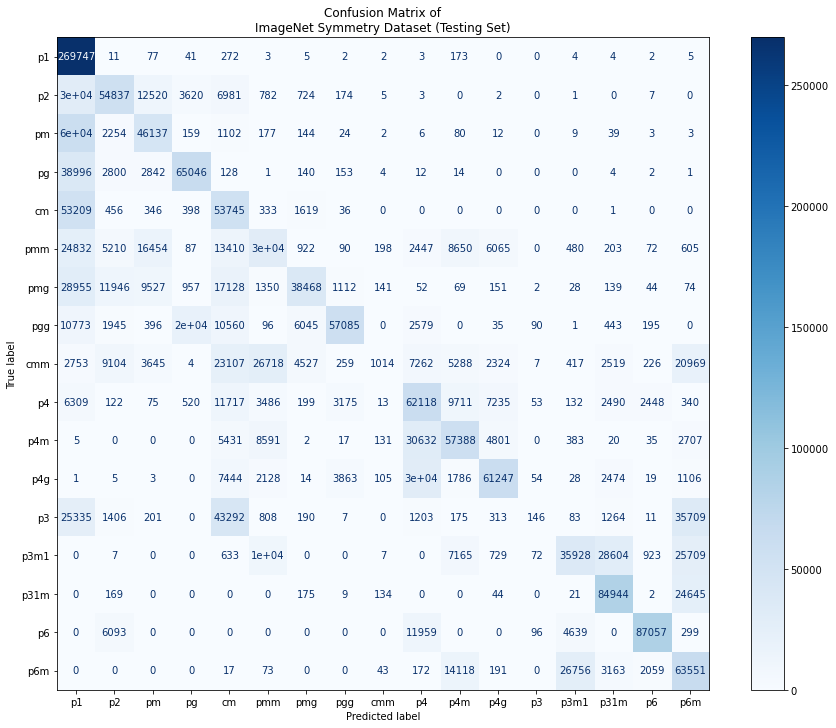

In [15]:
cm = np.load('./07242023-fpn_resnet50-test_cm.npy')

plot_cm(cm, symmetry_classes, save_file=None, title='\nImageNet Symmetry Dataset (Testing Set)', style='simple', figsize=(15,12))
# plot_cm(cm, symmetry_classes, save_file=None, style='with_axis')

# case analysis

In [16]:
 def parameter_analysis(classes, info_file, visualize=False, print_lens=False):
    if print_lens: print(len(classes))
        
    result = pd.DataFrame()
    for symmetry in classes:
        info_pd = pd.read_csv(info_file)

        data_1 = info_pd[info_pd['symmetry']==symmetry]
        data_2 = pd.DataFrame(data_1, columns=['radius_a','radius_b','unit_w','unit_h','repeat_w','repeat_h','angle_r','rot_angle'])

        values = pd.DataFrame({symmetry:data_2.mean()})
        if print_lens: print(f'{symmetry}: {len(data_1)} images.')
        result = pd.concat((result, values), axis=1)
    
    result = result.transpose()
    if visualize: 
        result.plot(kind='line', figsize=(12,10), xticks=np.arange(0,17))
    return result


def prediction_vs_actual(model, ds, dl, device, num_images=6):
    
    def ax_imshow(inp, ax, title=None):
        """Imshow for Tensor."""
        inp = inp.numpy().transpose((1, 2, 0))
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        inp = std * inp + mean
        inp = np.clip(inp, 0, 1)
        ax.imshow(inp)

    model.eval()
    fig = plt.figure(figsize=(10, num_images//3*3))

    with torch.no_grad():
        inputs, labels = next(iter(dl))
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        
    class_names = ds.classes

    for i in range(num_images):
    
        r = np.random.randint(0, inputs.size()[0])
        ax = fig.add_subplot(num_images//3, 3, i+1)
        ax.axis('off')
        ax.set_title(f'predicted: {class_names[preds[r]]}, actual:{class_names[labels[r]]}')
        ax_imshow(inputs.cpu().data[r], ax) 
        
    plt.show()


def most_confused(model, batch, t, p, classes, device, k=5):

    model.eval()    
    data, labels = batch
    data = data.to(device)
    labels = labels.to(device)
    model = model.to(device)

    data = data[torch.where(labels==t_n)]
    labels = labels[torch.where(labels==t_n)]
    pred_label = 0
    
    while pred_label != p:
        i = np.random.randint(0, data.shape[0])
        image, label = data[i], labels[i]

        image_nor = torch.clone(image)
        inp = image_nor.unsqueeze(0).to(device)
        output = model(inp)
        pred_label = torch.nn.Softmax(dim=1)(output).argmax(dim=1, keepdim=True)
    
    probs, values_ = torch.nn.Softmax(dim=1)(output).topk(k)
        
    plt.figure(figsize=(10,10))
    plt.subplot(1, 2, 1)
    plt.title(label)
    plt.imshow(image[:3].reshape(256,256,3))
    plt.subplot(1, 2, 2)
    plt.title(label)
    plt.imshow(image[3])
    plt.show()
    
    print(f'top {k} wrong precitions are: ')
    for prob, symmetry in zip(probs[0], classes):
          print(symmetry,':', round(prob.item()*100,6),'%')
            
            